In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import os, cv2
import numpy as np
import pandas as pd
import random, tqdm
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import albumentations as album


In [3]:
!pip install -q -U segmentation-models-pytorch albumentations > /dev/null
import segmentation_models_pytorch as smp

In [4]:
DATA_DIR = '/content/drive/MyDrive/Dataset'

metadata_df = pd.read_csv(os.path.join(DATA_DIR, 'metadata.csv'))
metadata_df = metadata_df[['frame_id', 'png_image_path', 'png_mask_path']]
metadata_df['png_image_path'] = metadata_df['png_image_path'].apply(lambda img_pth: os.path.join(DATA_DIR, img_pth))
metadata_df['png_mask_path'] = metadata_df['png_mask_path'].apply(lambda img_pth: os.path.join(DATA_DIR, img_pth))

metadata_df = metadata_df.sample(frac=1).reset_index(drop=True)


val_df = metadata_df.sample(frac=0.2, random_state=42)
tra_df = metadata_df.drop(val_df.index)
len(tra_df), len(val_df)

(490, 122)

In [5]:
class_dict = pd.read_csv(os.path.join(DATA_DIR, 'class_dict.csv'))

class_names = class_dict['class_names'].tolist()

class_rgb_values = class_dict[['r','g','b']].values.tolist()

print('All dataset classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

All dataset classes and their corresponding RGB values in labels:
Class Names:  ['background', 'polyp']
Class RGB values:  [[0, 0, 0], [255, 255, 255]]


In [6]:
select_classes = ['background', 'polyp']


select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Selected classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Selected classes and their corresponding RGB values in labels:
Class Names:  ['background', 'polyp']
Class RGB values:  [[0, 0, 0], [255, 255, 255]]


In [7]:
def visualize(**images):

    n_image = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_image, idx + 1)
        plt.xticks([]);
        plt.yticks([])

        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

In [8]:
def one_hot_encode(label, label_values):

    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map

In [9]:
def reverse_one_hot(image):

    x = np.argmax(image, axis = -1)
    return x

In [10]:
def colour_code_segmentation(image, label_values):

    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x

In [11]:
def get_bounding_boxes(mask, target_class_idx=1, min_area=10):
    """
    Extract bounding boxes for a specific class index from a mask.
    mask: numpy array (2D: HxW or 3D: HxWxC)
    target_class_idx: class index of the polyp
    min_area: ignore very small detections
    """
    # If mask is one-hot encoded or has probabilities
    if mask.ndim == 3:
        mask_gray = np.argmax(mask, axis=-1)  # Get class indices
    else:
        mask_gray = mask

    # Convert to binary mask for target class
    binary_mask = (mask_gray == target_class_idx).astype(np.uint8) * 255

    # Find contours
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    boxes = []
    for cnt in contours:
        if cv2.contourArea(cnt) >= min_area:  # filter tiny noise
            x, y, w, h = cv2.boundingRect(cnt)
            boxes.append((x, y, w, h))
    return boxes


In [12]:
def draw_boxes(image, boxes, color=(0, 255, 0), thickness=2):
    """
    Draw rectangles on image from list of boxes.
    """
    img_copy = image.copy()
    for (x, y, w, h) in boxes:
        cv2.rectangle(img_copy, (x, y), (x + w, y + h), color, thickness)
    return img_copy


In [13]:
class EndoscopyDataset(torch.utils.data.Dataset):
  def __init__(
            self,
            df,
            class_rgb_values=None,
            augmentation=None,
            preprocessing=None,
    ):
        self.image_paths = df['png_image_path'].tolist()
        self.mask_paths = df['png_mask_path'].tolist()

        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing

  def __getitem__(self, i):

        # read images and masks
        image = cv2.cvtColor(cv2.imread(self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)

        # one-hot-encode the mask
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        return image, mask

  def __len__(self):
        # return length of
        return len(self.image_paths)

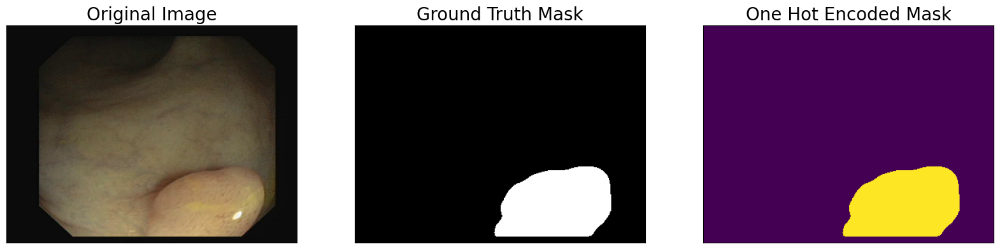

In [14]:
dataset = EndoscopyDataset(tra_df, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[2]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [15]:
def get_training_augmentation():
    train_transform = [
        album.HorizontalFlip(p=0.5),
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():
    test_transform = [
        album.PadIfNeeded(min_height=288, min_width=384, always_apply=True, border_mode=0),
    ]
    return album.Compose(test_transform)
def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))

    return album.Compose(_transform)

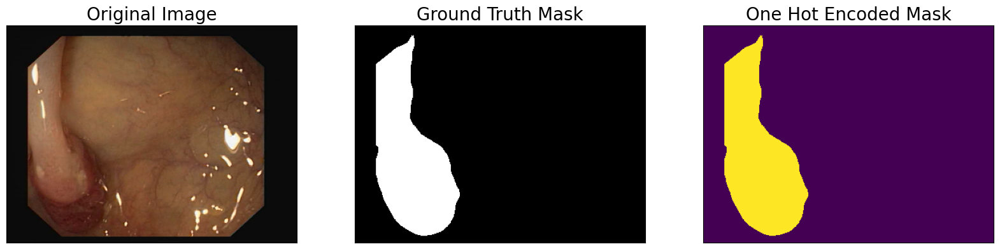

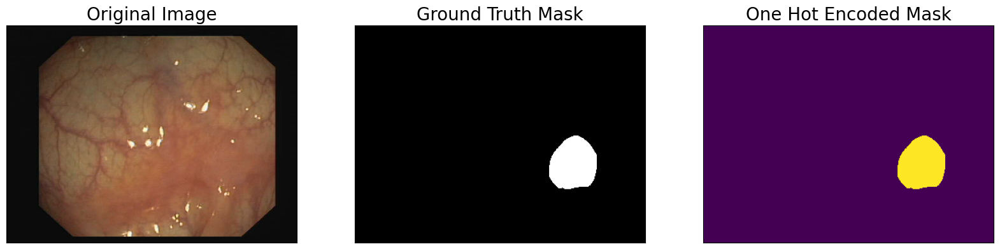

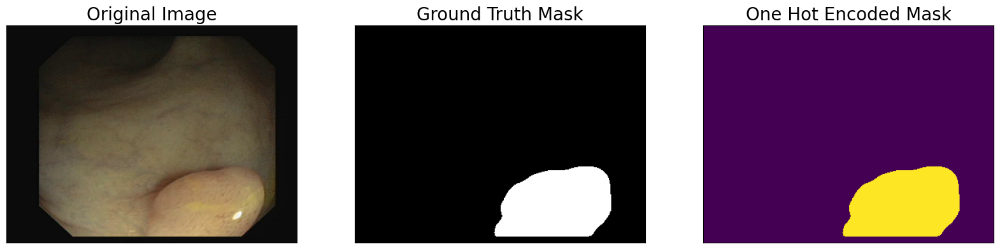

In [16]:
augmented_dataset = EndoscopyDataset(
    tra_df,
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on image/mask pairs
for idx in range(3):
    image, mask = augmented_dataset[idx]
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

In [17]:
ENCODER = 'resnet34'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = select_classes
ACTIVATION = 'sigmoid'

model = smp.Unet(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=len(CLASSES),
    activation=ACTIVATION,
)


preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [18]:
train_dataset = EndoscopyDataset(
    tra_df,
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

valid_dataset = EndoscopyDataset(
    val_df,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False, num_workers=4)

In [19]:
!pip install -U segmentation-models-pytorch


In [20]:
import segmentation_models_pytorch as smp


In [21]:
from segmentation_models_pytorch.utils.train import TrainEpoch, ValidEpoch
from segmentation_models_pytorch.utils.metrics import IoU
from segmentation_models_pytorch.utils.losses import DiceLoss

In [22]:
TRAINING = True

EPOCHS = 15
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
loss = smp.utils.losses.DiceLoss()
metrics = [smp.utils.metrics.IoU(threshold=0.5),]
optimizer = torch.optim.Adam([
    dict(params=model.parameters(), lr=0.00008),
])
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

In [23]:
train_epoch = smp.utils.train.TrainEpoch(
    model,
    loss=loss,
    metrics=metrics,
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

In [24]:
%%time

if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, './best_model.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 8/8 [00:20<00:00,  2.62s/it, dice_loss - 0.425, iou_score - 0.5243]
Model saved!

Epoch: 1
valid: 100%|██████████| 8/8 [00:03<00:00,  2.57it/s, dice_loss - 0.3379, iou_score - 0.7302]
Model saved!

Epoch: 2
valid: 100%|██████████| 8/8 [00:03<00:00,  2.43it/s, dice_loss - 0.297, iou_score - 0.7643]
Model saved!

Epoch: 3
valid: 100%|██████████| 8/8 [00:02<00:00,  2.74it/s, dice_loss - 0.2678, iou_score - 0.8188]
Model saved!

Epoch: 4
valid: 100%|██████████| 8/8 [00:02<00:00,  2.79it/s, dice_loss - 0.2416, iou_score - 0.9225]
Model saved!

Epoch: 5
valid: 100%|██████████| 8/8 [00:04<00:00,  1.85it/s, dice_loss - 0.2166, iou_score - 0.9547]
Model saved!

Epoch: 6
valid: 100%|██████████| 8/8 [00:02<00:00,  2.80it/s, dice_loss - 0.1962, iou_score - 0.9538]

Epoch: 7
valid: 100%|██████████| 8/8 [00:02<00:00,  2.80it/s, dice_loss - 0.1725, iou_score - 0.961]
Model saved!

Epoch: 8
valid: 100%|██████████| 8/8 [00:02<00:00,  2.72it/s, dice_loss - 0.1485, iou_s

In [25]:
# load best saved model checkpoint from the current run
if os.path.exists('./best_model.pth'):
    best_model = torch.load('./best_model.pth', map_location=DEVICE ,weights_only=False)
    print('Loaded UNet model from this run.')

# load best saved model checkpoint from previous commit (if present)
elif os.path.exists('../input/polyp-segmentation-in-colonoscopy-frames-deeplab/best_model.pth'):
    best_model = torch.load('../input/polyp-segmentation-in-colonoscopy-frames-deeplab/best_model.pth', map_location=DEVICE,weights_only=False)
    print('Loaded UNet model from a previous commit.')

Loaded UNet model from this run.


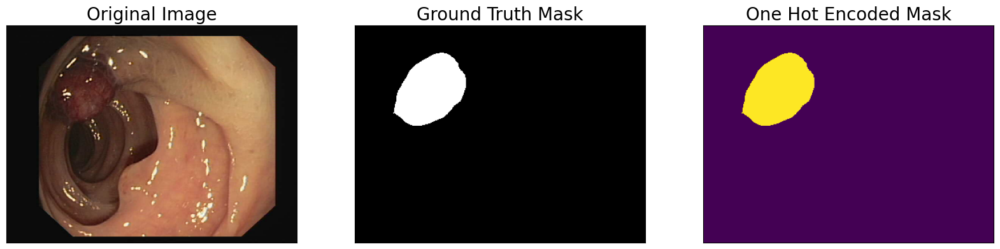

In [26]:
test_dataset = EndoscopyDataset(
    val_df,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

test_dataloader = DataLoader(test_dataset)

test_dataset_vis = EndoscopyDataset(
    val_df,
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [27]:
pip install -q segmentation-models-pytorch albumentations gradio grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 81.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [28]:
!pip install grad-cam --quiet

In [29]:
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import SemanticSegmentationTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import torchvision.transforms.functional as TF


rgb_image shape: (288, 384, 3)
grayscale_cam shape: (288, 384)


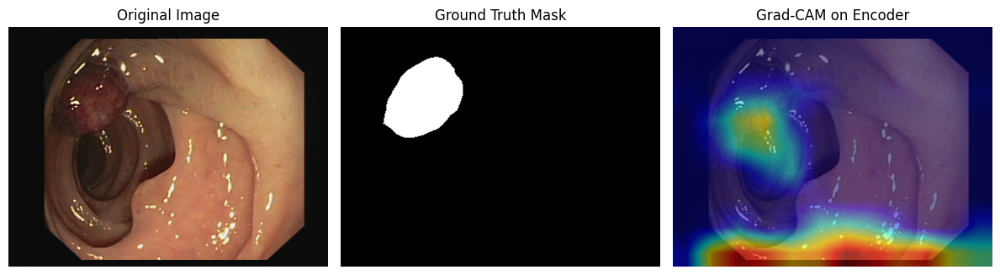

In [30]:
# Set model to eval mode
model.eval()
model.to(DEVICE)

if image.shape[-1] == 3:
    input_tensor = torch.from_numpy(image).permute(2, 0, 1)
else:
    input_tensor = torch.from_numpy(image)

input_tensor = input_tensor.unsqueeze(0).float()

_, _, h, w = input_tensor.shape
pad_h = (16 - h % 16) % 16
pad_w = (16 - w % 16) % 16

input_tensor = torch.nn.functional.pad(
    input_tensor, (0, pad_w, 0, pad_h), mode='reflect'
).to(DEVICE)

rgb_image = np.pad(image, ((0, pad_h), (0, pad_w), (0, 0)), mode='reflect')
rgb_image = (rgb_image - rgb_image.min()) / (rgb_image.max() - rgb_image.min())

target_layers = [model.encoder.layer4[-1]]

target_mask = reverse_one_hot(mask).squeeze()
targets = [SemanticSegmentationTarget(1, target_mask)]

cam = GradCAM(model=model, target_layers=target_layers)

grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0]

if grayscale_cam.ndim == 3 and grayscale_cam.shape[0] == 3:
    grayscale_cam = np.mean(grayscale_cam, axis=0)

print("rgb_image shape:", rgb_image.shape)
print("grayscale_cam shape:", grayscale_cam.shape)


cam_image = show_cam_on_image(rgb_image, grayscale_cam, use_rgb=True)

plt.figure(figsize=(12, 5))

plt.subplot(1, 3, 1)
plt.imshow(rgb_image)
plt.title("Original Image")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(target_mask, cmap='gray')
plt.title("Ground Truth Mask")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cam_image)
plt.title("Grad-CAM on Encoder")
plt.axis('off')

plt.tight_layout()
plt.show()

In [31]:
def crop_image(image, true_dimensions):
    return album.CenterCrop(p=1, height=true_dimensions[0], width=true_dimensions[1])(image=image)

In [32]:
sample_preds_folder = 'sample_predictions/'
sample_boxes_folder = 'sample_predictions_boxes/'
if not os.path.exists(sample_preds_folder):
  os.makedirs(sample_preds_folder, exist_ok=True)
  os.makedirs(sample_boxes_folder, exist_ok=True)

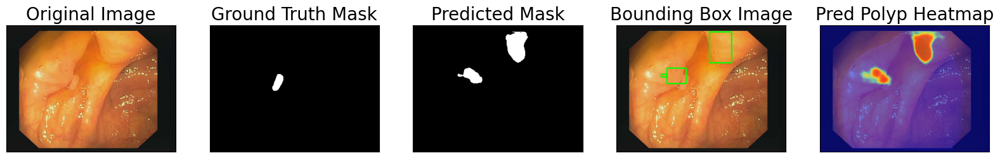

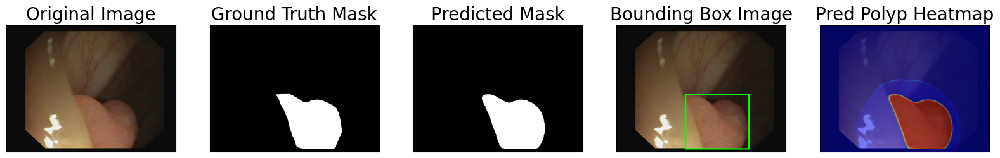

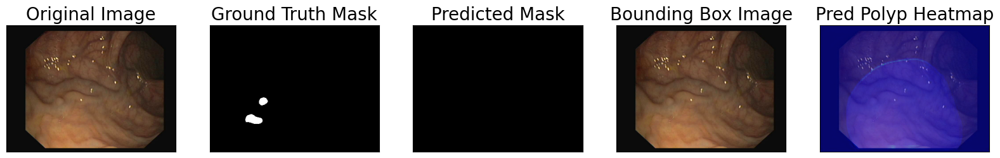

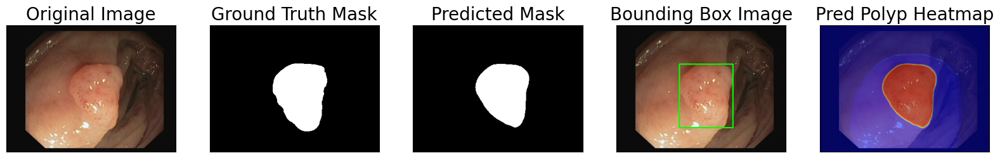

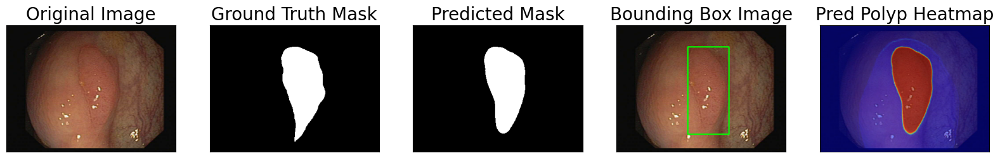

...

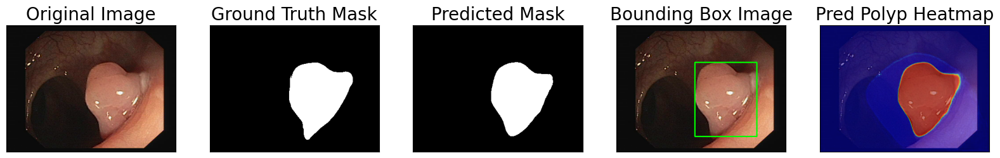

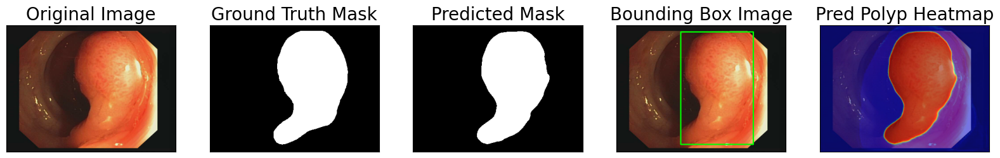

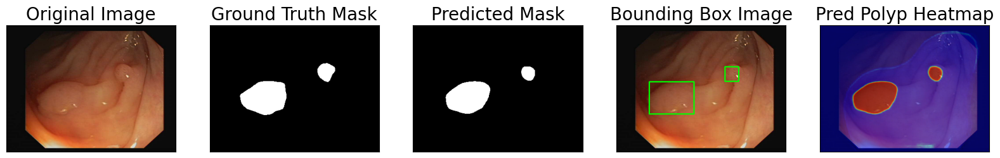

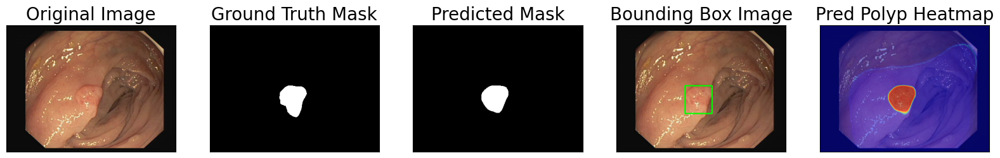

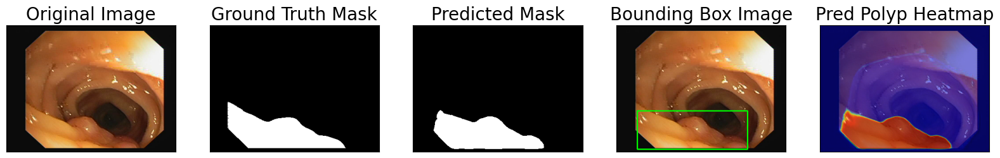

In [33]:
for idx in range(len(test_dataset)):
    image, gt_mask = test_dataset[idx]
    image_vis = test_dataset_vis[idx][0].astype('uint8')
    true_dimensions = image_vis.shape

    # Predict
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    pred_mask = np.transpose(pred_mask, (1, 2, 0))

    # ----- Step 1: Get binary mask for polyp -----
    polyp_class_idx = select_classes.index('polyp')
    binary_mask = (pred_mask[:, :, polyp_class_idx] > 0.5).astype(np.uint8)  # thresholding

    # Resize / crop binary mask to match image dims
    binary_mask = crop_image(binary_mask, true_dimensions)['image']

    # ----- Step 2: Get bounding boxes from binary mask -----
    boxes = get_bounding_boxes(binary_mask, target_class_idx=1)  # 1 = polyp in binary mask
    boxed_image = draw_boxes(image_vis, boxes)

    # ----- Step 3: Create visualizations -----
    pred_mask_colored = crop_image(
        colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values),
        true_dimensions
    )['image']

    gt_mask = np.transpose(gt_mask, (1, 2, 0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values), true_dimensions)['image']

    # Save triplet: original | GT | prediction
    triplet = np.hstack([image_vis, gt_mask, pred_mask_colored])
    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), triplet[:, :, ::-1])

    # Save image with bounding boxes
    cv2.imwrite(os.path.join(sample_boxes_folder, f"sample_pred_boxes_{idx}.png"), boxed_image[:, :, ::-1])

    polyp_score_map = crop_image(pred_mask[:, :, polyp_class_idx], true_dimensions)['image']  # HxW float
# Normalize original image to [0,1] float as expected by show_cam_on_image
    rgb_image_float = (image_vis - image_vis.min()) / (image_vis.max() - image_vis.min() + 1e-6)
    rgb_image_float = rgb_image_float.astype(np.float32)
# Create overlay using the same utility used for Grad-CAM
    pred_polyp_heatmap_overlay = show_cam_on_image(rgb_image_float, polyp_score_map.astype(np.float32), use_rgb=True)

    visualize(
        original_image=image_vis,
        ground_truth_mask=gt_mask,
        predicted_mask=pred_mask_colored,
        bounding_box_image=boxed_image,
        pred_polyp_heatmap=pred_polyp_heatmap_overlay
)

In [34]:
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_dataloader)
print("Evaluation on Test Data: ")
print(f"Mean IoU Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Dice Loss: {valid_logs['dice_loss']:.4f}")

valid: 100%|██████████| 122/122 [00:05<00:00, 21.70it/s, dice_loss - 0.07855, iou_score - 0.9769]
Evaluation on Test Data: 
Mean IoU Score: 0.9769
Mean Dice Loss: 0.0786


In [35]:
def preprocess_input(image_np):
    true_dimensions = image_np.shape[:2]
    image_rgb = cv2.cvtColor(image_np, cv2.COLOR_BGR2RGB)

    # Apply resizing or padding if required
    padded = get_validation_augmentation()(image=image_rgb)
    image = padded['image']

    # Apply preprocessing
    preprocessed = get_preprocessing(preprocessing_fn)(image=image)
    image = preprocessed['image']

    return image, true_dimensions


In [36]:
def predict_polyp_segmentation(image_input):
    image_np = np.array(image_input)

    # Preprocess input
    image, true_dimensions = preprocess_input(image_np)
    x_tensor = torch.from_numpy(image).unsqueeze(0).to(DEVICE)

    # Predict segmentation mask
    with torch.no_grad():
        pred_mask = best_model(x_tensor)
        pred_mask = pred_mask.squeeze().cpu().numpy()

    pred_mask = np.transpose(pred_mask, (1, 2, 0))

    # ----- Step 1: Get binary mask for polyp -----
    polyp_class_idx = select_classes.index('polyp')
    binary_mask = (pred_mask[:, :, polyp_class_idx] > 0.5).astype(np.uint8)  # threshold
    binary_mask = crop_image(binary_mask, true_dimensions)['image']

    # ----- Step 2: Get bounding boxes from binary mask -----
    boxes = get_bounding_boxes(binary_mask, target_class_idx=1)  # 1 = polyp
    boxed_image = draw_boxes(image_np, boxes)

    # ----- Step 3: Create heatmap & segmentation visualization -----
    pred_heatmap = crop_image(pred_mask[:, :, polyp_class_idx], true_dimensions)['image']
    pred_segmentation = crop_image(
        colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values),
        true_dimensions
    )['image']

    # Grad-CAM
    input_tensor = torch.nn.functional.pad(
        x_tensor, (0, 0, 0, 0), mode='reflect'
    )
    rgb_image = (image_np - image_np.min()) / (image_np.max() - image_np.min())
    rgb_image = rgb_image.astype(np.float32)

    cam = GradCAM(model=model, target_layers=[model.encoder.layer4[-1]])
    targets = [SemanticSegmentationTarget(1, reverse_one_hot(pred_mask))]
    grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0]

    # Resize CAM to match input
    grayscale_cam_resized = cv2.resize(grayscale_cam, (rgb_image.shape[1], rgb_image.shape[0]))
    cam_image = show_cam_on_image(rgb_image, grayscale_cam_resized, use_rgb=True)

    # Return visualizations
    return [
        image_np,
        pred_segmentation,
        pred_heatmap,
        cam_image,
        boxed_image
    ]


In [37]:
model.eval()
model.to(DEVICE)

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track

In [38]:
import gradio as gr

# Interface
interface = gr.Interface(
    fn=predict_polyp_segmentation,
    inputs=gr.Image(type="numpy", label="Upload Colonoscopy Frame"),
    outputs=[
        gr.Image(type="numpy", label="Original Image"),
        gr.Image(type="numpy", label="Predicted Segmentation"),
        gr.Image(type="numpy", label="Polyp Heatmap"),
        gr.Image(type="numpy", label="Grad-CAM Overlay"),
        gr.Image(type="numpy", label="Bounding Boxes")
    ],
    title="Polyp Segmentation in Colonoscopy Frames",
    description="Upload an endoscopic image to get polyp segmentation prediction using DeepLabV3+."
)


interface.launch(debug=True, share=True)


Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://1ff97c473e82e0383b.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://1ff97c473e82e0383b.gradio.live
